<a href="https://colab.research.google.com/github/pradeepvaranasi/fintech_casestudy/blob/main/FinTech_CaseStudy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Business Objective


**Goal:** An online FinTech platform is committed to delivering customized loan products to millennials. They innovate in an otherwise dull loan segment, to deliver instant, flexible loans on consumer friendly terms to salaried professionals and businessmen.

**Objective:** The data science team is building an underwriting layer to determine the creditworthiness of MSMEs as well as individuals.

FinTech company deploys formal credit to salaried individuals and businesses 4 main financial instruments:

Personal Loan
EMI Free Loan
Personal Overdraft
Advance Salary Loan

This case study will focus on the underwriting process behind Personal Loan only


### Exploratory Data Analysis

#### Importing Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
import plotly.express as px

In [ ]:
# Establishing the connection between Colab and Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Importing the data from gdrive
data = pd.read_csv('drive/MyDrive/FinTech_CaseStudy/data.csv')

In [ ]:
# Displaying all the columns
pd.set_option('display.max_columns', None)

In [ ]:
# Checking the output for first n rows
data.head()

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,dti,earliest_cr_line,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address
0,10000.0,36 months,11.44,329.48,B,B4,Marketing,10+ years,RENT,117000.0,Not Verified,Jan-2015,Fully Paid,vacation,Vacation,26.24,Jun-1990,16.0,0.0,36369.0,41.8,25.0,w,INDIVIDUAL,0.0,0.0,"0174 Michelle Gateway\r\nMendozaberg, OK 22690"
1,8000.0,36 months,11.99,265.68,B,B5,Credit analyst,4 years,MORTGAGE,65000.0,Not Verified,Jan-2015,Fully Paid,debt_consolidation,Debt consolidation,22.05,Jul-2004,17.0,0.0,20131.0,53.3,27.0,f,INDIVIDUAL,3.0,0.0,"1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113"
2,15600.0,36 months,10.49,506.97,B,B3,Statistician,< 1 year,RENT,43057.0,Source Verified,Jan-2015,Fully Paid,credit_card,Credit card refinancing,12.79,Aug-2007,13.0,0.0,11987.0,92.2,26.0,f,INDIVIDUAL,0.0,0.0,"87025 Mark Dale Apt. 269\r\nNew Sabrina, WV 05113"
3,7200.0,36 months,6.49,220.65,A,A2,Client Advocate,6 years,RENT,54000.0,Not Verified,Nov-2014,Fully Paid,credit_card,Credit card refinancing,2.60,Sep-2006,6.0,0.0,5472.0,21.5,13.0,f,INDIVIDUAL,0.0,0.0,"823 Reid Ford\r\nDelacruzside, MA 00813"
4,24375.0,60 months,17.27,609.33,C,C5,Destiny Management Inc.,9 years,MORTGAGE,55000.0,Verified,Apr-2013,Charged Off,credit_card,Credit Card Refinance,33.95,Mar-1999,13.0,0.0,24584.0,69.8,43.0,f,INDIVIDUAL,1.0,0.0,"679 Luna Roads\r\nGreggshire, VA 11650"


In [ ]:
df = data.copy()

In [ ]:
df.head()

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,dti,earliest_cr_line,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address
0,10000.0,36 months,11.44,329.48,B,B4,Marketing,10+ years,RENT,117000.0,Not Verified,Jan-2015,Fully Paid,vacation,Vacation,26.24,Jun-1990,16.0,0.0,36369.0,41.8,25.0,w,INDIVIDUAL,0.0,0.0,"0174 Michelle Gateway\r\nMendozaberg, OK 22690"
1,8000.0,36 months,11.99,265.68,B,B5,Credit analyst,4 years,MORTGAGE,65000.0,Not Verified,Jan-2015,Fully Paid,debt_consolidation,Debt consolidation,22.05,Jul-2004,17.0,0.0,20131.0,53.3,27.0,f,INDIVIDUAL,3.0,0.0,"1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113"
2,15600.0,36 months,10.49,506.97,B,B3,Statistician,< 1 year,RENT,43057.0,Source Verified,Jan-2015,Fully Paid,credit_card,Credit card refinancing,12.79,Aug-2007,13.0,0.0,11987.0,92.2,26.0,f,INDIVIDUAL,0.0,0.0,"87025 Mark Dale Apt. 269\r\nNew Sabrina, WV 05113"
3,7200.0,36 months,6.49,220.65,A,A2,Client Advocate,6 years,RENT,54000.0,Not Verified,Nov-2014,Fully Paid,credit_card,Credit card refinancing,2.60,Sep-2006,6.0,0.0,5472.0,21.5,13.0,f,INDIVIDUAL,0.0,0.0,"823 Reid Ford\r\nDelacruzside, MA 00813"
4,24375.0,60 months,17.27,609.33,C,C5,Destiny Management Inc.,9 years,MORTGAGE,55000.0,Verified,Apr-2013,Charged Off,credit_card,Credit Card Refinance,33.95,Mar-1999,13.0,0.0,24584.0,69.8,43.0,f,INDIVIDUAL,1.0,0.0,"679 Luna Roads\r\nGreggshire, VA 11650"


####Attributes Exploration

In [ ]:
# Checking the shape of df
df.shape

(396030, 27)

In [ ]:
df[df.duplicated() == True].shape

(0, 27)

In [ ]:
# Checking the info of df
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396030 entries, 0 to 396029
Data columns (total 27 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   loan_amnt             396030 non-null  float64
 1   term                  396030 non-null  object 
 2   int_rate              396030 non-null  float64
 3   installment           396030 non-null  float64
 4   grade                 396030 non-null  object 
 5   sub_grade             396030 non-null  object 
 6   emp_title             373103 non-null  object 
 7   emp_length            377729 non-null  object 
 8   home_ownership        396030 non-null  object 
 9   annual_inc            396030 non-null  float64
 10  verification_status   396030 non-null  object 
 11  issue_d               396030 non-null  object 
 12  loan_status           396030 non-null  object 
 13  purpose               396030 non-null  object 
 14  title                 394275 non-null  object 
 15  

In [93]:
df.describe(include='all')

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,dti,earliest_cr_line,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address,issue_d_month,issue_d_year,earliest_cr_line_month,earliest_cr_line_year,term_num
count,396030.000000,396030,396030.000000,396030.000000,396030,396030,396030,396030,396030,396030.000000,396030,396030,396030,396030,396030,396030.000000,396030,396030.000000,396030.000000,396030.000000,396030.000000,396030.000000,396030,396030,396030.000000,396030.000000,396030,396030,396030.000000,396030,396030.000000,396030.000000
unique,NaN,2,NaN,NaN,7,35,173106,11,6,NaN,3,115,2,14,48817,NaN,684,NaN,NaN,NaN,NaN,NaN,2,3,NaN,NaN,393700,12,NaN,12,NaN,NaN
top,NaN,36 months,NaN,NaN,B,B3,Others,10+ years,MORTGAGE,NaN,Verified,Oct-2014,Fully Paid,debt_consolidation,Debt consolidation,NaN,Oct-2000,NaN,NaN,NaN,NaN,NaN,f,INDIVIDUAL,NaN,NaN,USCGC Smith\r\nFPO AE 70466,Oct,NaN,Oct,NaN,NaN
freq,NaN,302005,NaN,NaN,116018,26655,22927,144342,198348,NaN,139563,14846,318357,234507,154227,NaN,3017,NaN,NaN,NaN,NaN,NaN,238066,395319,NaN,NaN,8,42130,NaN,38291,NaN,NaN
mean,13475.922152,NaN,13.473726,411.179402,NaN,NaN,NaN,NaN,NaN,68675.139960,NaN,NaN,NaN,NaN,NaN,17.170923,NaN,10.920408,0.125594,13248.552271,54.219382,24.564334,NaN,NaN,1.404656,0.108047,NaN,NaN,2013.629074,NaN,1997.857667,41.698053
std,6489.043163,NaN,3.439978,185.194870,NaN,NaN,NaN,NaN,NaN,26790.379737,NaN,NaN,NaN,NaN,NaN,6.355316,NaN,3.766669,0.331392,8512.399943,19.709813,8.887153,NaN,NaN,1.691927,0.310441,NaN,NaN,1.481725,NaN,7.198387,10.212038
min,3250.000000,NaN,6.890000,109.510000,NaN,NaN,NaN,NaN,NaN,28000.000000,NaN,NaN,NaN,NaN,NaN,4.680000,NaN,5.000000,0.000000,1685.000000,11.200000,9.000000,NaN,NaN,0.000000,0.000000,NaN,NaN,2007.000000,NaN,1944.000000,36.000000
25%,8650.000000,NaN,11.120000,275.890000,NaN,NaN,NaN,NaN,NaN,50000.000000,NaN,NaN,NaN,NaN,NaN,12.480000,NaN,8.000000,0.000000,6957.000000,40.000000,18.000000,NaN,NaN,0.000000,0.000000,NaN,NaN,2013.000000,NaN,1994.000000,36.000000
50%,12000.000000,NaN,13.330000,375.430000,NaN,NaN,NaN,NaN,NaN,64000.000000,NaN,NaN,NaN,NaN,NaN,16.910000,NaN,10.000000,0.000000,11181.000000,54.800000,24.000000,NaN,NaN,1.000000,0.000000,NaN,NaN,2014.000000,NaN,1999.000000,36.000000
75%,17975.000000,NaN,15.610000,517.480000,NaN,NaN,NaN,NaN,NaN,83000.000000,NaN,NaN,NaN,NaN,NaN,21.600000,NaN,13.000000,0.000000,17362.750000,69.000000,30.000000,NaN,NaN,2.000000,0.000000,NaN,NaN,2015.000000,NaN,2003.000000,36.000000


In [ ]:
round(df['loan_status'].value_counts(normalize=True)*100,2)

Fully Paid     80.39
Charged Off    19.61
Name: loan_status, dtype: float64

#### Missing Value Imputation

In [ ]:
df.isnull().sum()

loan_amnt                   0
term                        0
int_rate                    0
installment                 0
grade                       0
sub_grade                   0
emp_title               22927
emp_length              18301
home_ownership              0
annual_inc                  0
verification_status         0
issue_d                     0
loan_status                 0
purpose                     0
title                    1755
dti                         0
earliest_cr_line            0
open_acc                    0
pub_rec                     0
revol_bal                   0
revol_util                276
total_acc                   0
initial_list_status         0
application_type            0
mort_acc                37795
pub_rec_bankruptcies      535
address                     0
dtype: int64

In [ ]:
df['emp_title'].fillna('Others', inplace=True)

In [ ]:
round(df['emp_length'].value_counts(normalize=True)*100,2)

10+ years    33.37
2 years       9.48
< 1 year      8.40
3 years       8.38
5 years       7.01
1 year        6.85
4 years       6.34
6 years       5.52
7 years       5.51
8 years       5.07
9 years       4.05
Name: emp_length, dtype: float64

In [ ]:
df['emp_length'].fillna('10+ years', inplace=True)

In [ ]:
round(df['emp_length'].value_counts(normalize=True)*100,2)

10+ years    36.45
2 years       9.05
< 1 year      8.01
3 years       8.00
5 years       6.69
1 year        6.54
4 years       6.05
6 years       5.26
7 years       5.26
8 years       4.84
9 years       3.87
Name: emp_length, dtype: float64

In [ ]:
round(df['title'].value_counts(normalize=True)*100,2)

Debt consolidation            38.67
Credit card refinancing       13.06
Home improvement               3.87
Other                          3.28
Debt Consolidation             2.94
                              ...  
Graduation/Travel Expenses     0.00
Daughter's Wedding Bill        0.00
gotta move                     0.00
creditcardrefi                 0.00
Toxic Debt Payoff              0.00
Name: title, Length: 48817, dtype: float64

In [ ]:
df['title'].fillna('Debt consolidation', inplace=True)

In [ ]:
df[['revol_util']].mean()

revol_util    53.791749
dtype: float64

In [ ]:
df[['revol_util']].median()

revol_util    54.8
dtype: float64

In [ ]:
df['revol_util'].fillna(54.8, inplace=True)

In [ ]:
round(df['mort_acc'].value_counts(normalize=True)*100,2)

0.0     39.02
1.0     16.86
2.0     13.94
3.0     10.62
4.0      7.78
5.0      5.08
6.0      3.09
7.0      1.69
8.0      0.87
9.0      0.46
10.0     0.24
11.0     0.13
12.0     0.07
13.0     0.04
14.0     0.03
15.0     0.02
16.0     0.01
17.0     0.01
18.0     0.01
19.0     0.00
20.0     0.00
24.0     0.00
22.0     0.00
21.0     0.00
25.0     0.00
27.0     0.00
32.0     0.00
31.0     0.00
23.0     0.00
26.0     0.00
28.0     0.00
30.0     0.00
34.0     0.00
Name: mort_acc, dtype: float64

In [ ]:
df['mort_acc'].fillna(0, inplace=True)

In [ ]:
round(df['pub_rec_bankruptcies'].value_counts(normalize=True)*100,2)

0.0    88.59
1.0    10.82
2.0     0.47
3.0     0.09
4.0     0.02
5.0     0.01
6.0     0.00
7.0     0.00
8.0     0.00
Name: pub_rec_bankruptcies, dtype: float64

In [ ]:
df['pub_rec_bankruptcies'].fillna(0, inplace=True)

#### Outlier Analysis

In [ ]:
for col in df.columns:
  if df[col].dtype != object:
    print("+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++")
    print("Column Name: ", col)
    print("+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++")
    fig = px.box(df, y=col)
    fig.show()



+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  loan_amnt


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  int_rate


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  installment


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  annual_inc


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  dti


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  open_acc


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  pub_rec


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  revol_bal


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  revol_util


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  total_acc


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  mort_acc


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  pub_rec_bankruptcies


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


In [ ]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

<ipython-input-30-d7397e803310>:1: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

<ipython-input-30-d7397e803310>:2: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



loan_amnt               12000.00
int_rate                    6.00
installment               316.97
annual_inc              45000.00
dti                        11.70
open_acc                    6.00
pub_rec                     0.00
revol_bal               13595.00
revol_util                 37.00
total_acc                  15.00
mort_acc                    3.00
pub_rec_bankruptcies        0.00
dtype: float64


In [ ]:
# Treat Outliers

def treat_outliers(col):
  if df[col].dtype != object:
    mean_q = (df[col].quantile(0.50))
    lower_q = (df[col].quantile(0.05))
    upper_q = (df[col].quantile(0.95))
    df[col] = np.where(df[col] < lower_q, mean_q, df[col])
    df[col] = np.where(df[col] > upper_q, mean_q, df[col])


In [ ]:
for col in df.columns:
  treat_outliers(col)

In [ ]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

loan_amnt                9325.00
int_rate                    4.49
installment               241.59
annual_inc              33000.00
dti                         9.12
open_acc                    5.00
pub_rec                     0.00
revol_bal               10405.75
revol_util                 29.00
total_acc                  12.00
mort_acc                    2.00
pub_rec_bankruptcies        0.00
dtype: float64


<ipython-input-33-d7397e803310>:1: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

<ipython-input-33-d7397e803310>:2: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



#### Feature Engineering

In [85]:
df['issue_d'].head()

0    Jan-2015
1    Jan-2015
2    Jan-2015
3    Nov-2014
4    Apr-2013
Name: issue_d, dtype: object

In [87]:
df['issue_d_month'] = df['issue_d'].str[:3]
df['issue_d_year'] = (df['issue_d'].str[4:8]).astype(int)

In [86]:
df['earliest_cr_line'].head()

0    Jun-1990
1    Jul-2004
2    Aug-2007
3    Sep-2006
4    Mar-1999
Name: earliest_cr_line, dtype: object

In [88]:
df['earliest_cr_line_month'] = df['earliest_cr_line'].str[:3]
df['earliest_cr_line_year'] = (df['earliest_cr_line'].str[4:8]).astype(int)

In [80]:
df['term'].head()

0     36 months
1     36 months
2     36 months
3     36 months
4     60 months
Name: term, dtype: object

In [89]:
df['term_num'] = (df['term'].str[0:3]).astype(int)

In [76]:
df['address'].str.extract(r'\b(\w+)$').head()

,0
0,22690
1,05113
2,05113
3,00813
4,11650


In [77]:
df['address'].head()

0       0174 Michelle Gateway\r\nMendozaberg, OK 22690
1    1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113
2    87025 Mark Dale Apt. 269\r\nNew Sabrina, WV 05113
3              823 Reid Ford\r\nDelacruzside, MA 00813
4               679 Luna Roads\r\nGreggshire, VA 11650
Name: address, dtype: object

In [90]:
df.head(2)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,dti,earliest_cr_line,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address,issue_d_month,issue_d_year,earliest_cr_line_month,earliest_cr_line_year,term_num
0,10000.0,36 months,11.44,329.48,B,B4,Marketing,10+ years,RENT,117000.0,Not Verified,Jan-2015,Fully Paid,vacation,Vacation,26.24,Jun-1990,16.0,0.0,36369.0,41.8,25.0,w,INDIVIDUAL,0.0,0.0,"0174 Michelle Gateway\r\nMendozaberg, OK 22690",Jan,2015,Jun,1990,36
1,8000.0,36 months,11.99,265.68,B,B5,Credit analyst,4 years,MORTGAGE,65000.0,Not Verified,Jan-2015,Fully Paid,debt_consolidation,Debt consolidation,22.05,Jul-2004,17.0,0.0,20131.0,53.3,27.0,f,INDIVIDUAL,3.0,0.0,"1076 Carney Fort Apt. 347\r\nLoganmouth, SD 05113",Jan,2015,Jul,2004,36


#### Univariate/BiVariate/Multivariate

In [94]:
df.describe(include='all')

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,dti,earliest_cr_line,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address,issue_d_month,issue_d_year,earliest_cr_line_month,earliest_cr_line_year,term_num
count,396030.000000,396030,396030.000000,396030.000000,396030,396030,396030,396030,396030,396030.000000,396030,396030,396030,396030,396030,396030.000000,396030,396030.000000,396030.000000,396030.000000,396030.000000,396030.000000,396030,396030,396030.000000,396030.000000,396030,396030,396030.000000,396030,396030.000000,396030.000000
unique,NaN,2,NaN,NaN,7,35,173106,11,6,NaN,3,115,2,14,48817,NaN,684,NaN,NaN,NaN,NaN,NaN,2,3,NaN,NaN,393700,12,NaN,12,NaN,NaN
top,NaN,36 months,NaN,NaN,B,B3,Others,10+ years,MORTGAGE,NaN,Verified,Oct-2014,Fully Paid,debt_consolidation,Debt consolidation,NaN,Oct-2000,NaN,NaN,NaN,NaN,NaN,f,INDIVIDUAL,NaN,NaN,USCGC Smith\r\nFPO AE 70466,Oct,NaN,Oct,NaN,NaN
freq,NaN,302005,NaN,NaN,116018,26655,22927,144342,198348,NaN,139563,14846,318357,234507,154227,NaN,3017,NaN,NaN,NaN,NaN,NaN,238066,395319,NaN,NaN,8,42130,NaN,38291,NaN,NaN
mean,13475.922152,NaN,13.473726,411.179402,NaN,NaN,NaN,NaN,NaN,68675.139960,NaN,NaN,NaN,NaN,NaN,17.170923,NaN,10.920408,0.125594,13248.552271,54.219382,24.564334,NaN,NaN,1.404656,0.108047,NaN,NaN,2013.629074,NaN,1997.857667,41.698053
std,6489.043163,NaN,3.439978,185.194870,NaN,NaN,NaN,NaN,NaN,26790.379737,NaN,NaN,NaN,NaN,NaN,6.355316,NaN,3.766669,0.331392,8512.399943,19.709813,8.887153,NaN,NaN,1.691927,0.310441,NaN,NaN,1.481725,NaN,7.198387,10.212038
min,3250.000000,NaN,6.890000,109.510000,NaN,NaN,NaN,NaN,NaN,28000.000000,NaN,NaN,NaN,NaN,NaN,4.680000,NaN,5.000000,0.000000,1685.000000,11.200000,9.000000,NaN,NaN,0.000000,0.000000,NaN,NaN,2007.000000,NaN,1944.000000,36.000000
25%,8650.000000,NaN,11.120000,275.890000,NaN,NaN,NaN,NaN,NaN,50000.000000,NaN,NaN,NaN,NaN,NaN,12.480000,NaN,8.000000,0.000000,6957.000000,40.000000,18.000000,NaN,NaN,0.000000,0.000000,NaN,NaN,2013.000000,NaN,1994.000000,36.000000
50%,12000.000000,NaN,13.330000,375.430000,NaN,NaN,NaN,NaN,NaN,64000.000000,NaN,NaN,NaN,NaN,NaN,16.910000,NaN,10.000000,0.000000,11181.000000,54.800000,24.000000,NaN,NaN,1.000000,0.000000,NaN,NaN,2014.000000,NaN,1999.000000,36.000000
75%,17975.000000,NaN,15.610000,517.480000,NaN,NaN,NaN,NaN,NaN,83000.000000,NaN,NaN,NaN,NaN,NaN,21.600000,NaN,13.000000,0.000000,17362.750000,69.000000,30.000000,NaN,NaN,2.000000,0.000000,NaN,NaN,2015.000000,NaN,2003.000000,36.000000


++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  loan_amnt
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


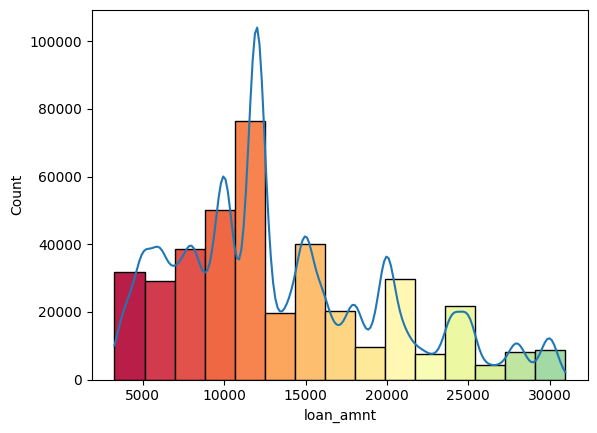

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  int_rate
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


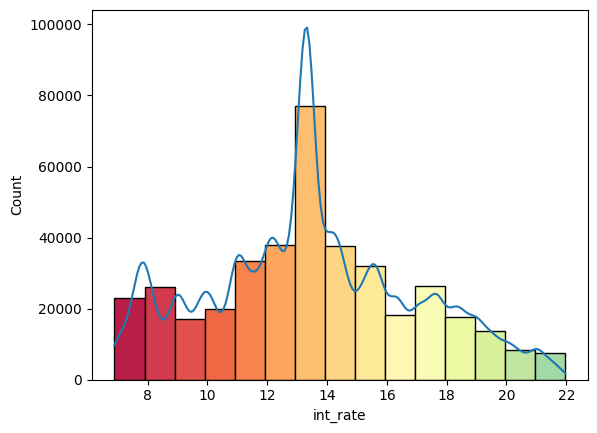

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  installment
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


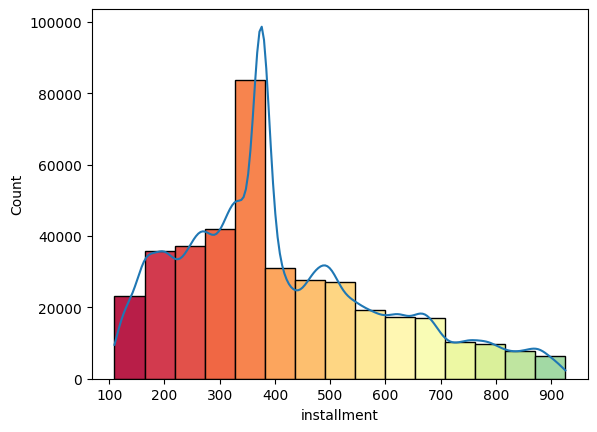

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  annual_inc
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


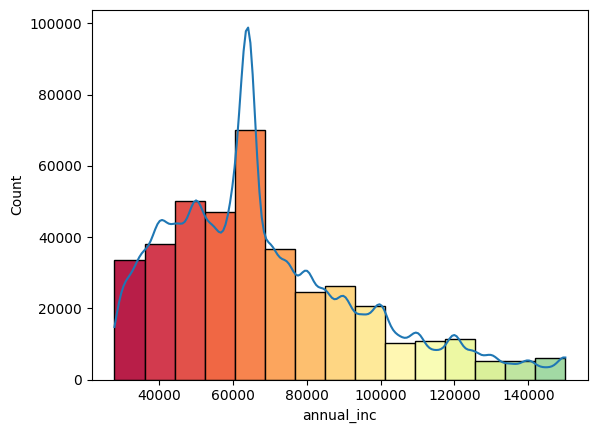

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  dti
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


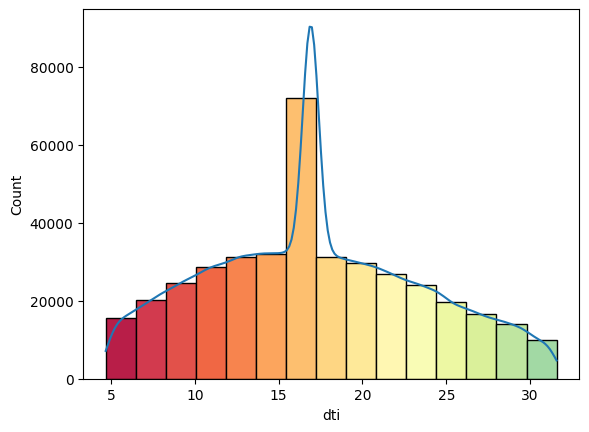

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  open_acc
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


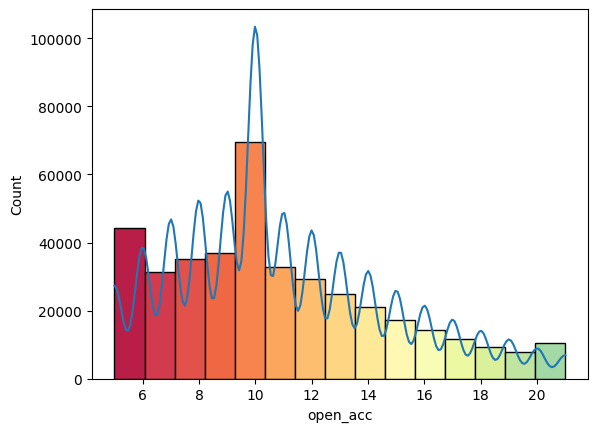

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  revol_bal
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


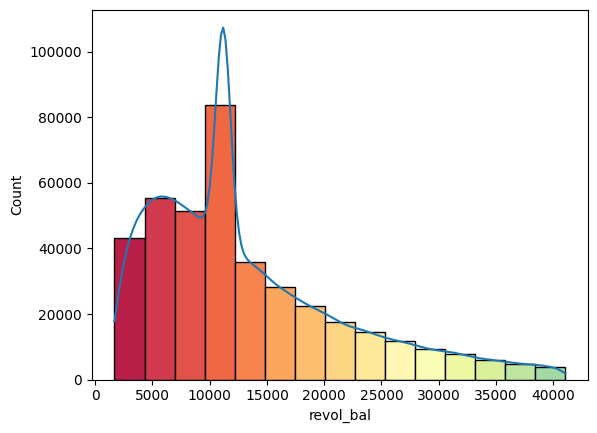

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  revol_util
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


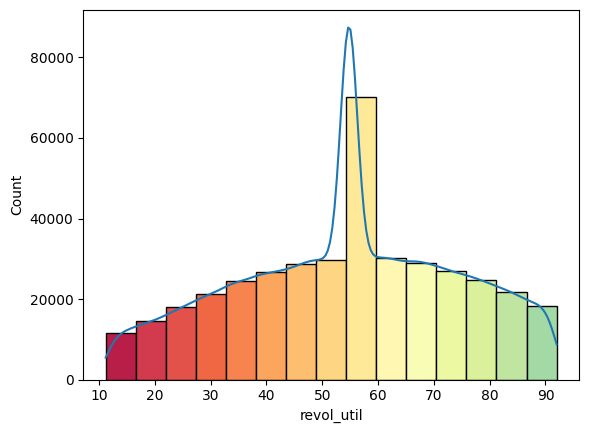

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Column Name:  total_acc
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


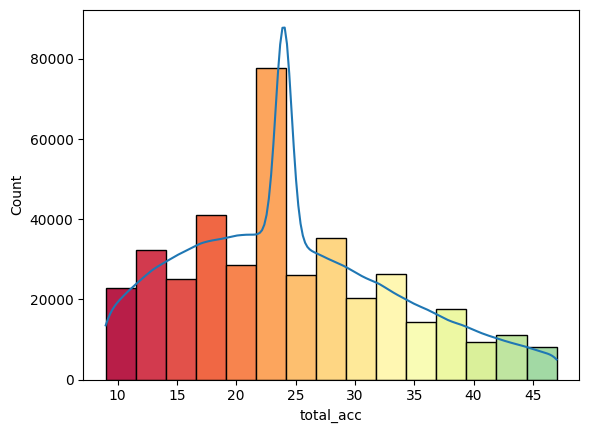

In [100]:
cont_col = ['loan_amnt', 'int_rate', 'installment', 'annual_inc', 'dti',
            'open_acc', 'revol_bal', 'revol_util', 'total_acc']

for col in cont_col:
  print("++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++")
  print("Column Name: ", col)
  print("++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++")
  cm = sns.color_palette("Spectral",20)
  plot = sns.histplot(df[col], bins=15, kde=True)

  for bin_,i in zip(plot.patches,cm):
      bin_.set_facecolor(i)

  plt.show()


In [98]:
df['term_num'].value_counts()

36    302005
60     94025
Name: term_num, dtype: int64